# Manifold

author: steeve.laquitaine@epfl.ch  

**method**:

* task parameters (see bbp_workflow config):
    * start delay: 1000 ms
    * stimulus delay: 1500 ms
    * 360 stimuli x 50 repeated trials for characterizing the tuning curves
    * interstimulus interval: 200 ms


* data:
    1. 36 simulation files
    2. bbp_workflow config script spikesorting_stim_rotations.py indicates 36 files with orientations for file 1: 0 to 9, file 2: 10 to 19 etc...
    3. png files confirm point 2): /gpfs/bbp.cscs.ch/project/proj83/scratch/home/isbister/post_physiology_2023/sim_data/campaigns/spikesorting_stimulus_tests/4_spikesorting_stimulus_test_neuropixels_8-1-24/4_spikesorting_stimulus_test_neuropixels_8-1-24__8slc_80f_360r_50t_200ms_1_smallest_fiber_gids/0fcb7709-b1e9-4d84-b056-5801f20d55af/35
    5. Thus: Each simulation file is organized as: simulation file duration (101500 ms) = start delay of 1500 ms then 10 repeats of (orientation for 9800 ms followed by 200 ms of ISI)


Starting from:
* Manifold of ground truth [done]  
* Manifold of spike sorted single-units (isolated with KSLabel only, has all the single-unit biases) -> what the best sorters produce.  

Qualitative impact of biases:
* Manifold of single-units (only the predominant **mixed:overmerging + oversplitting** type) -> isolate the effect of the biases.
* Manifold of spike sorted single-units (overmerging only type) -> isolate the effect of overmerging.
* Manifold of spike sorted single-units (oversplitting type) -> isolate the effect of oversplitting.
* Manifold including multi-units (with multi-units, cite Shenoy's work) and its discrimination capacity -> the worst case (all biases).

Quantitative: discrimination capacities (and manifolds?) after sorted unit curation with our model -> significant improvement

Our improvement:
* above with our novel curation method -> improvement

### Requirements

* https://github.com/schung039/neural_manifolds_replicaMFT.git

### Setup

Setup `manifold` env

In [1]:
# SETUP PACKAGES 
%load_ext autoreload
%autoreload 2
import os
import numpy as np
from matplotlib import pyplot as plt
from matplotlib.gridspec import GridSpec
import spikeinterface as si
import numpy as np
from collections import Counter
import pandas as pd
from sklearn.decomposition import PCA # dimensionality reduction
from mftma.manifold_analysis_correlation import manifold_analysis_corr
import random
import seaborn as sns
from collections import defaultdict
import pickle
import warnings
warnings.filterwarnings("ignore", category=DeprecationWarning) 
warnings.filterwarnings("ignore", category=UserWarning) 

# SET PROJECT PATH
PROJ_PATH = "/gpfs/bbp.cscs.ch/project/proj85/home/laquitai/preprint_2023"
os.chdir(PROJ_PATH)
from src.nodes import utils
from src.nodes.utils import get_config
from src.nodes.analysis.code import igeom

# SETUP CONFIG
data_conf, _ = get_config("silico_neuropixels", "stimulus").values()
GT = data_conf["sorting"]["simulation"]["ground_truth"]["full"]["output"]
REC = data_conf["probe_wiring"]["output"]
IGEOM = data_conf["analyses"]["neural_code"]["igeom"]

# SORTINGS
K4 = data_conf["sorting"]["sorters"]["kilosort4"]["full"]["output"]
K3 = data_conf["sorting"]["sorters"]["kilosort3"]["full"]["output"]
K25 = data_conf["sorting"]["sorters"]["kilosort2_5"]["full"]["output"]
K2 = data_conf["sorting"]["sorters"]["kilosort2"]["full"]["output"]
KS = data_conf["sorting"]["sorters"]["kilosort"]["full"]["output"]
HS = data_conf["sorting"]["sorters"]["herdingspikes"]["full"]["output"]


# SETUP QUALITY PATH
quality_path = "/gpfs/bbp.cscs.ch/project/proj85/laquitai/spikebias_paper/dataeng/0_silico/4_spikesorting_stimulus_test_neuropixels_8-1-24__8slc_80f_360r_50t_200ms_1_smallest_fiber_gids/0fcb7709-b1e9-4d84-b056-5801f20d55af/analysis/sorting_quality/sorting_quality_1h.csv"

# TASK DESIGN PARAMETERS
N_SIMS = 36 # number of simulation files
SELECT_PERIOD = False

# FIGURE SETTINGS
COLOR_VIVO = (0.7, 0.7, 0.7)
COLOR_SILI = (0.84, 0.27, 0.2)
COLOR_STIM = (0.6, 0.75, 0.1)
BOX_ASPECT = 1                  # square fig
plt.rcParams['figure.figsize'] = (2,1)
plt.rcParams["font.family"] = "Arial"
plt.rcParams["font.size"] = 6
plt.rcParams['lines.linewidth'] = 0.5
plt.rcParams['axes.linewidth'] = 0.5
plt.rcParams['axes.spines.top'] = False
plt.rcParams['axes.spines.right'] = False
plt.rcParams['xtick.major.width'] = 0.3
plt.rcParams['xtick.minor.size'] = 0.1
plt.rcParams['xtick.major.size'] = 1.5
plt.rcParams['ytick.major.size'] = 1.5
plt.rcParams['ytick.major.width'] = 0.3
legend_cfg = {"frameon": False, "handletextpad": 0.1}
savefig_cfg = {"transparent":True, "dpi": 300} 

2024-10-02 09:45:40,298 - root - utils.py - get_config - INFO - Reading experiment config.
2024-10-02 09:45:40,392 - root - utils.py - get_config - INFO - Reading experiment config. - done


## Load datasets

In [2]:
# get sorted unit quality classification
quality_df = pd.read_csv(quality_path)

# get true evoked ata
SortingTrue = si.load_extractor(GT)
Recording = si.load_extractor(REC)
duration_secs = Recording.get_total_duration()
SFREQ = SortingTrue.get_sampling_frequency()

# get SortingExtractors
SortingK4 = si.load_extractor(K4)
SortingK3 = si.load_extractor(K3)
SortingK25 = si.load_extractor(K25)
SortingK2 = si.load_extractor(K2)
SortingKS = si.load_extractor(KS)
SortingHS = si.load_extractor(HS)

# get task epoch infos
task = igeom.get_task_parameters(
    start_delay=500,
    n_orientations=10,
    n_repeats=50,
    stimulus_duration=200,
    n_simulations=36,
)

# get stimulus directions and intervals (ms)
stimulus_labels = igeom.get_stimulus_labels()
stimulus_intervals_ms = igeom.get_stimulus_intervals_ms(
    task["epoch_labels"], task["epoch_ms"]
)

# parameters

# takes 20 secs
FIG_SIZE = (6, 10)
N_PANELS = 7

# set parameters
params = {"orientations": stimulus_labels}
params_pca = {
    "dims": 3,  # dimensions
    "orientations": params["orientations"],  # stimulus orientations
}

# compute unit x stimulus response matrix
gt_resp = igeom.compute_response_by_stim_matrix(
    SortingTrue.unit_ids, SortingTrue, stimulus_intervals_ms
)

# setup SortingExtractors
# with single-unit curation
sortingextractors1 = [
    SortingK4,
    SortingK3,
    SortingK25,
    SortingK2,
]
# no single-unit curation
sortingextractors2 = [SortingKS, SortingHS]

print(f"stimulus directions {stimulus_labels.shape}: {stimulus_labels}")
print(f"stimulus intervals (ms)({len(stimulus_intervals_ms)}): {stimulus_intervals_ms}")

stimulus directions (18000,): [  0   0   0 ... 359 359 359]
stimulus intervals (ms)(18000): [(500, 700), (700, 900), (900, 1100), (1100, 1300), (1300, 1500), (1500, 1700), (1700, 1900), (1900, 2100), (2100, 2300), (2300, 2500), (2500, 2700), (2700, 2900), (2900, 3100), (3100, 3300), (3300, 3500), (3500, 3700), (3700, 3900), (3900, 4100), (4100, 4300), (4300, 4500), (4500, 4700), (4700, 4900), (4900, 5100), (5100, 5300), (5300, 5500), (5500, 5700), (5700, 5900), (5900, 6100), (6100, 6300), (6300, 6500), (6500, 6700), (6700, 6900), (6900, 7100), (7100, 7300), (7300, 7500), (7500, 7700), (7700, 7900), (7900, 8100), (8100, 8300), (8300, 8500), (8500, 8700), (8700, 8900), (8900, 9100), (9100, 9300), (9300, 9500), (9500, 9700), (9700, 9900), (9900, 10100), (10100, 10300), (10300, 10500), (10500, 10700), (10700, 10900), (10900, 11100), (11100, 11300), (11300, 11500), (11500, 11700), (11700, 11900), (11900, 12100), (12100, 12300), (12300, 12500), (12500, 12700), (12700, 12900), (12900, 13100),

## Plot manifolds

### (20s) Single-units

* all 360 whisker deflection directions are represented
* that is the best output produced by the spike sorters

manifold axis max: 1.0
manifold axis min: -0.5180597493385422
manifold axis max: 1.0
manifold axis min: -0.28699335718889757
manifold axis max: 1.0
manifold axis min: -0.44096172214820667
manifold axis max: 1.0
manifold axis min: -0.3297815950190703
manifold axis max: 1.0
manifold axis min: -0.3712153135210608
manifold axis max: 1.0
manifold axis min: -0.24925116509287776
manifold axis max: 1.0
manifold axis min: -0.4487369772080063


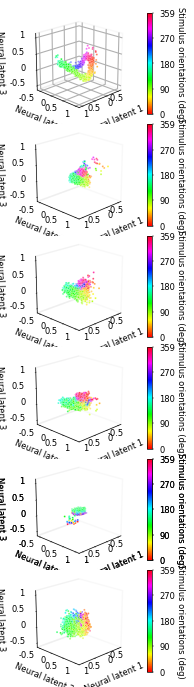

In [9]:
# plot
fig = plt.figure(figsize=FIG_SIZE)

# panel 1: ground truth
ax = fig.add_subplot(N_PANELS, 1, 1, projection="3d")
manifold = igeom.plot_manifold_from_pca(gt_resp, params_pca, ax, axis_lim=[-0.6, 1.1])

# panels 2 to 4: loop over sorters (w/ single-unit curation)
# record
# sorters name are standardized as in the quality table
# loaded below
sorter = ["KS4", "KS3", "KS2.5", "KS2"]

# plot
out_data = dict()
c_ix = 0
for s_ix, Sorting in enumerate(sortingextractors1, start=2):
    ax = fig.add_subplot(N_PANELS, 1, s_ix, projection="3d")
    out_data[sorter[c_ix]] = igeom.plot_sorted_manifolds2(
        ax, Sorting, stimulus_intervals_ms, params_pca, axis_lim=[-0.6, 1.1]
    )
    c_ix += 1
    ax.grid(False)

# panels 5 and 6: loop over KS and HS (no single-unit curation)
# record
sorter = ["KS", "HS"]

# plot
c_ix = 0
for s_ix, Sorting in enumerate(sortingextractors2, start=5):
    ax = fig.add_subplot(N_PANELS, 1, s_ix, projection="3d")
    out_data[sorter[c_ix]] = igeom.plot_all_sorted_unit_manifolds2(
        ax, Sorting, stimulus_intervals_ms, params_pca, axis_lim=[-0.6, 1.1]
    )
    c_ix += 1
    ax.grid(False)

# tidy up
fig.subplots_adjust(wspace=0.1, hspace=0.1)

# save figure
utils.savefig(PROJ_PATH + "/figures/4_code/single_unit_manifolds.svg")

## Capacity

* **Class manifold**: "The set of all state vectors corresponding to responses to all possible stimuli associated with the same object can be viewed as a manifold in the neural state space” [Chung et al., 2017]
* The **load**: of the neural population is alpha = P/N.
* The **manifold capacity**:
    * is the critical load: alpha_c. It is the critical number of object manifolds, P, that can be linearly separated (by a linear hyperplane through the origin [Chung et al., 2017]) given N features. It is the linearly decodable information about object per unit. 
    * It captures the linear separability of object manifolds. 
    * If the load alpha=P/N is below the manifold capacity alpha_c, most object manifold are separable, else most are inseparable.
    * **lower bound**: “The manifold capacity for point-cloud manifolds is lower bounded by the case where there is no manifold structure.” [Stephenson et al., 2020]
* The **manifold dimension**:
    * upper bound is min(M,N) where M is the number of points per manifold (50 sample instances in our case) and N is the number of units.

* The **Margin**: 
    * “The robustness of a linear classifier is quantified by the margin, which measures the distance between the separating hyperplane and the closest point.” [Chung et al., 2017]

Method:
* the unit populations have different unit sizes, so the manifold capacity must be normalized.

### (3m) Ground truth

In [10]:
# parameters
# nb of new neural latents resulting
# from Gaussian random projection
N_NEW = 200

# sample 20 classes out of the 360
# (360 is computationally intensive)
sample_classes = np.arange(0, 360, 18)

# number of sample instances per class
n_exple_per_class = sum(params["orientations"] == 0)

### (40m) Sorted unit classes

In [11]:
# parameters
params = {
    "stimulus_labels": stimulus_labels,
    "sample_classes": sample_classes,
    "n_exple_per_class": n_exple_per_class,
    "n_new": N_NEW,
    "seed": 0,
}

# SortingExtractors
sorter = ["KS4", "KS3", "KS2.5", "KS2", "KS", "HS"]
se = [SortingK4, SortingK3, SortingK25, SortingK2, SortingKS, SortingHS]

# minimum unit sample size required
# else loss function can be nan
MIN_NB_UNITS = 10

#### Format dataset

* TODO: 
    * we can also bootstrap the unit class to get the same sample size as the ground truth.

In [12]:
# Ground truth -------------------------------------------------------

class_data = defaultdict(dict)
class_data["ground_truth"]["ground_truth"] = dict()
class_data["ground_truth"]["ground_truth"]["unit_id"] = SortingTrue.unit_ids
class_data["ground_truth"]["ground_truth"]["responses"] = gt_resp

# MULTI, SINGLE-UNITS and ALL UNIT CLASSES -------------------------------------------------------

# loop over sorted unit classes and record the data
# for each class
for s_i, sorter_i in enumerate(sorter):

    # record data for single unit class
    if sorter_i in ["KS4", "KS3", "KS2.5", "KS2"]:

        # single-unit exclusively
        # record the unit and responses in this class
        class_data[sorter_i]["single-unit"] = dict()
        class_data[sorter_i]["single-unit"]["unit_id"] = out_data[sorter_i]["unit_ids"]
        class_data[sorter_i]["single-unit"]["responses"] = out_data[sorter_i][
            "responses"
        ]

        # multi-unit exclusively
        # record the unit and responses in this class
        out = igeom.get_multiunit_sorted_responses(se[s_i], stimulus_intervals_ms)
        class_data[sorter_i]["multi-unit"] = dict()
        class_data[sorter_i]["multi-unit"]["unit_id"] = out["unit_ids"]
        class_data[sorter_i]["multi-unit"]["responses"] = out["responses"]

    # all units including single and multi-units
    out = igeom.get_all_sorted_responses(se[s_i], stimulus_intervals_ms)
    class_data[sorter_i]["all sorted units"] = dict()
    class_data[sorter_i]["all sorted units"]["unit_id"] = out["unit_ids"]
    class_data[sorter_i]["all sorted units"]["responses"] = out["responses"]

# BIASED SINGLE-UNIT CLASSES -------------------------------------------------------

# loop over sorted unit classes and add the data
# for each bias class
for _, sorter_i in enumerate(sorter):

    # bias classes
    u_classes = quality_df[quality_df.sorter == sorter_i].quality.unique()

    # loop over bias classes
    for _, u_class in enumerate(u_classes):

        # record the units in this class
        class_data[sorter_i][u_class] = dict()
        class_data[sorter_i][u_class]["unit_id"] = quality_df.sorted[
            (quality_df.sorter == sorter_i) & (quality_df.quality == u_class)
        ].values

        # record their responses
        unit_loc = np.isin(
            out_data[sorter_i]["unit_ids"], class_data[sorter_i][u_class]["unit_id"]
        )
        class_data[sorter_i][u_class]["responses"] = out_data[sorter_i]["responses"][
            unit_loc
        ]

# examples
print(class_data.keys())
print(class_data["KS4"].keys())

dict_keys(['ground_truth', 'KS4', 'KS3', 'KS2.5', 'KS2', 'KS', 'HS'])
dict_keys(['single-unit', 'multi-unit', 'all sorted units', 'mixed: good + overmerger + oversplitter', 'mixed: overmerger + oversplitter'])


In [35]:
# (40m) get information geometry metrics (capacity, ...)
np.random.seed(0)

# get the smallest unit sample size among unit classes
# we will use it for all classes to avoid biases caused by
# using different sample sizes
min_sample_size = igeom.get_min_sample_size(sorter, class_data, MIN_NB_UNITS)
print("Smallest sample size:", min_sample_size)

# loop over sorters and record info-geom
igeom_data = defaultdict(dict)

# Ground truth -------------------------

# calculate information geometrical metrics
ix = np.random.permutation(np.arange(0, min_sample_size, 1))
sampled_resp = class_data["ground_truth"]["ground_truth"]["responses"][ix, :]
igeom_data["ground_truth"]["ground_truth"] = dict()
igeom_data["ground_truth"]["ground_truth"] = igeom.get_true_infogeometry(
    sampled_resp, **params
)

# Sorted units -------------------------

for s_i, sorter_i in enumerate(sorter):

    # loop over sorted unit classes
    for _, u_class in enumerate(class_data[sorter_i]):

        # if has the minimum unit sample size
        if len(class_data[sorter_i][u_class]["unit_id"]) >= MIN_NB_UNITS:

            # sample min_sample_size units
            ix = np.random.permutation(np.arange(0, min_sample_size, 1))
            sampled_resp = class_data[sorter_i][u_class]["responses"][ix, :]

            # calculate information geometrical metrics
            igeom_data[sorter_i][u_class] = igeom.get_infogeometry_for_sorter(
                sampled_resp, **params
            )
        else:
            # set to None
            igeom_data[sorter_i][u_class] = defaultdict(dict)
            igeom_data[sorter_i][u_class]["data"] = None
            igeom_data[sorter_i][u_class]["shuffled"] = None

# report
print("classes (count):", len(sample_classes))
print("unit (count):", gt_resp.shape[0])
print("load:", len(sample_classes) / gt_resp.shape[0])

# save
utils.create_if_not_exists(os.path.dirname(IGEOM))
# with open(IGEOM, "wb") as f:
#     pickle.dump(igeom_data, f)

Smallest sample size: 60
Optimizing...
Iteration    Cost                       Gradient norm     
---------    -----------------------    --------------    
   1         +1.3708282920258812e+01    1.96931281e+00    
   2         +1.2266342276654393e+01    1.03009901e+00    
   3         +1.2103916283577995e+01    4.46966807e-01    
   4         +1.2022618080552022e+01    4.22484382e-01    
   5         +1.1980270188220601e+01    3.98811376e-01    
   6         +1.1964737493598580e+01    2.48309730e-01    
   7         +1.1959152659743513e+01    1.25574652e-01    
   8         +1.1957460590940574e+01    8.92890598e-02    
   9         +1.1955928134883239e+01    5.08966418e-02    
  10         +1.1955051960796625e+01    2.30841665e-02    
  11         +1.1954882149993921e+01    1.88347230e-02    
  12         +1.1954811731625043e+01    9.64069169e-03    
  13         +1.1954789007946703e+01    6.43053749e-03    
  14         +1.1954771243934321e+01    4.99494113e-03    
  15         +1.1

### Plot

* Observations:
    * true manifold has a lower radius, dimensionality and centroid correlation, which explain why it also shows higher capacity than the spike-sorted datasets, as expected.
    * lower centroid correlation would be expected, but its centroid correlation is higher than the other two conditions' correlations.


#### Capacity

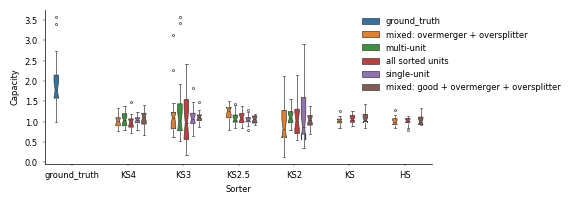

In [31]:
# set plot parameters
BOXPLOT_PMS = {
    "notch": True,
    "gap": 0.3,
    "width": 0.7,
    "linewidth": 0.5,
    "flierprops": {
        "marker": "o",
        "markerfacecolor": "w",
        "markersize": 1.5,
        "markeredgewidth": 0.5,
    },
}

df = pd.read_csv(IGEOM)
df

# df = pd.DataFrame()

fig, ax = plt.subplots(1, 1, figsize=(5, 2))

# # ground truth
# for s_i, sorter_i in enumerate(list(igeom_data.keys())):

#     # loop over sorted unit classes
#     for _, u_class in enumerate(list(igeom_data[sorter_i].keys())):

#         if not igeom_data[sorter_i][u_class]["data"] is None:

#             # get data and shuffled capacity
#             data_cap = igeom_data[sorter_i][u_class]["data"]["metrics_per_class"][
#                 "capacity"
#             ]
#             shuffled_cap = igeom_data[sorter_i][u_class]["shuffled"][
#                 "metrics_per_class"
#             ]["capacity"]

#             # build dataframe
#             df_i = pd.DataFrame(data=data_cap / shuffled_cap, columns=["Capacity"])
#             df_i["Unit class"] = u_class
#             df_i["Sorter"] = sorter_i
#             df = pd.concat([df, df_i])

# plot
ax = sns.boxplot(
    ax=ax,
    data=df,
    x="Sorter",
    y="Capacity",
    hue="Unit class",
    hue_order=[
        "ground_truth",
        "mixed: overmerger + oversplitter",
        "multi-unit",
        "all sorted units",
        "single-unit",
        "mixed: good + overmerger + oversplitter",
    ],
    # palette=[cl["COLOR_NV"], cl["COLOR_NS"], cl["COLOR_NE"], cl["COLOR_NB"]],
    **BOXPLOT_PMS,
    # vert=False
)

ax.legend(frameon=False, loc="upper left", bbox_to_anchor=(0.8, 1))

/tmp/ipykernel_34479/2090403399.py:45: FutureWarning: The default value of numeric_only in DataFrame.median is deprecated. In a future version, it will default to False. In addition, specifying 'numeric_only=None' is deprecated. Select only valid columns or specify the value of numeric_only to silence this warning.
  median_t = np.round(plot_data[plot_data["variable"] == "Truth"].median().values[0], 2)
/tmp/ipykernel_34479/2090403399.py:47: FutureWarning: The default value of numeric_only in DataFrame.median is deprecated. In a future version, it will default to False. In addition, specifying 'numeric_only=None' is deprecated. Select only valid columns or specify the value of numeric_only to silence this warning.
  plot_data[plot_data["variable"] == "Sorted single units"].median().values[0], 2
/tmp/ipykernel_34479/2090403399.py:83: FutureWarning: The default value of numeric_only in DataFrame.median is deprecated. In a future version, it will default to False. In addition, specifying '

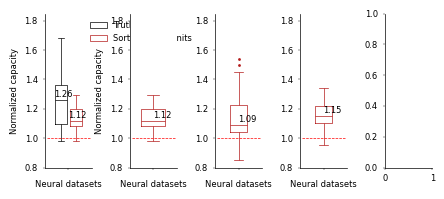

In [57]:
# GAP = 0.2
# MARKERSIZE = 2
# YLIM = [0.8, 1.85]
# colors = [
#     "k",  # True
#     [0.7, 0.1, 0.1],  # "Well detected" (strong red)
# ]

# fig, axes = plt.subplots(1, 5, figsize=(5, 2))

# # KS 4.0 --------------------

# plot_data = pd.DataFrame()
# plot_data["Truth"] = (
#     out_true["true_units"][0]["metrics_per_class"]["capacity"]
#     / out_true["true_units"][1]["metrics_per_class"]["capacity"]
# )
# plot_data["Sorted single units"] = (
#     out_ks3["data"]["metrics_per_class"]["capacity"]
#     / out_ks3["shuffled"]["metrics_per_class"]["capacity"]
# )
# plot_data = plot_data.melt()

# # plot
# ax = sns.boxplot(
#     ax=axes[0],
#     data=plot_data,
#     hue="variable",
#     y="value",
#     fill=False,
#     palette=colors,
#     gap=GAP,
#     linewidth=plt.rcParams["lines.linewidth"],
#     flierprops={"marker": ".", "markersize": MARKERSIZE},
#     width=0.7,
# )
# axes[0].spines[["top", "right"]].set_visible(False)
# axes[0].legend(frameon=False, loc="upper left", bbox_to_anchor=(0.8, 1))
# axes[0].set_ylabel("Normalized capacity")
# axes[0].set_xlabel("Neural datasets")
# axes[0].set_ylim(YLIM)
# axes[0].hlines(y=1, xmin=-0.5, xmax=0.5, color="r", linestyle="--")

# # annotate
# median_t = np.round(plot_data[plot_data["variable"] == "Truth"].median().values[0], 2)
# median_s = np.round(
#     plot_data[plot_data["variable"] == "Sorted single units"].median().values[0], 2
# )
# axes[0].annotate(text=median_t, xy=(-0.34, median_t + 0.02))
# axes[0].annotate(text=median_s, xy=(0, median_s + 0.02))

# # KS 3.0 --------------------

# plot_data = pd.DataFrame()
# plot_data["Sorted single units"] = (
#     out_ks3["data"]["metrics_per_class"]["capacity"]
#     / out_ks3["shuffled"]["metrics_per_class"]["capacity"]
# )
# plot_data = plot_data.melt()

# # plot
# ax = sns.boxplot(
#     ax=axes[1],
#     data=plot_data,
#     hue="variable",
#     y="value",
#     fill=False,
#     palette=colors[1:],
#     gap=GAP,
#     linewidth=plt.rcParams["lines.linewidth"],
#     flierprops={"marker": ".", "markersize": MARKERSIZE},
#     width=0.7,
# )
# axes[1].spines[["top", "right"]].set_visible(False)
# axes[1].get_legend().remove()
# axes[1].set_ylabel("Normalized capacity")
# axes[1].set_xlabel("Neural datasets")
# axes[1].set_ylim(YLIM)
# axes[1].hlines(y=1, xmin=-0.5, xmax=0.5, color="r", linestyle="--")

# # annotate
# median_s = np.round(
#     plot_data[plot_data["variable"] == "Sorted single units"].median().values[0], 2
# )
# axes[1].annotate(text=median_s, xy=(0, median_s + 0.02))

# # KS 2.5 --------------------

# plot_data = pd.DataFrame()
# plot_data["Sorted single units"] = (
#     out_ks25["data"]["metrics_per_class"]["capacity"]
#     / out_ks25["shuffled"]["metrics_per_class"]["capacity"]
# )
# plot_data = plot_data.melt()

# # plot
# ax = sns.boxplot(
#     ax=axes[2],
#     data=plot_data,
#     hue="variable",
#     y="value",
#     fill=False,
#     palette=colors[1:],
#     gap=GAP,
#     linewidth=plt.rcParams["lines.linewidth"],
#     flierprops={"marker": ".", "markersize": MARKERSIZE},
#     width=0.5,
# )
# # axes[1].legend(frameon=False, loc="upper left", bbox_to_anchor=(0.8, 1))
# axes[2].get_legend().remove()
# axes[2].spines[["top", "right"]].set_visible(False)
# axes[2].set_ylabel("")
# axes[2].set_xlabel("Neural datasets")
# axes[2].set_ylim(YLIM)
# axes[2].hlines(y=1, xmin=-0.5, xmax=0.5, color="r", linestyle="--")

# # annotate
# median_s = np.round(
#     plot_data[plot_data["variable"] == "Sorted single units"].median().values[0], 2
# )
# axes[2].annotate(text=median_s, xy=(0, median_s + 0.02))


# # KS 2 --------------------

# plot_data = pd.DataFrame()
# plot_data["Sorted single units"] = (
#     out_ks2["data"]["metrics_per_class"]["capacity"]
#     / out_ks2["shuffled"]["metrics_per_class"]["capacity"]
# )
# plot_data = plot_data.melt()

# # plot
# ax = sns.boxplot(
#     ax=axes[3],
#     data=plot_data,
#     hue="variable",
#     y="value",
#     fill=False,
#     palette=colors[1:],
#     gap=GAP,
#     linewidth=plt.rcParams["lines.linewidth"],
#     flierprops={"marker": ".", "markersize": MARKERSIZE},
#     width=0.5,
# )
# # axes[1].legend(frameon=False, loc="upper left", bbox_to_anchor=(0.8, 1))
# axes[3].get_legend().remove()
# axes[3].spines[["top", "right"]].set_visible(False)
# axes[3].set_ylabel("")
# axes[3].set_xlabel("Neural datasets")
# axes[3].set_ylim(YLIM)
# axes[3].hlines(y=1, xmin=-0.5, xmax=0.5, color="r", linestyle="--")

# # annotate
# median_s = np.round(
#     plot_data[plot_data["variable"] == "Sorted single units"].median().values[0], 2
# )
# axes[3].annotate(text=median_s, xy=(0, median_s + 0.02))


# # # HS  --------------------

# # plot_data = pd.DataFrame()
# # plot_data["All sorted units"] = (
# #     out_hs["all_sorted_units"][0]["metrics_per_class"]["capacity"]
# #     / out_hs["all_sorted_units"][1]["metrics_per_class"]["capacity"]
# # )
# # plot_data = plot_data.melt()

# # # plot
# # ax = sns.boxplot(
# #     ax=axes[2],
# #     data=plot_data,
# #     hue="variable",
# #     y="value",
# #     fill=False,
# #     palette=colors[2:],
# #     gap=GAP,
# #     linewidth=plt.rcParams["lines.linewidth"],
# #     flierprops={"marker": ".", "markersize": MARKERSIZE},
# #     width=0.2,
# # )
# # # axes[2].legend(frameon=False, loc="upper left", bbox_to_anchor=(0.8, 1))
# # axes[2].get_legend().remove()
# # axes[2].spines[["top", "right"]].set_visible(False)
# # axes[2].set_ylabel("")
# # axes[2].set_xlabel("Neural datasets")
# # axes[2].set_ylim(YLIM)

# # # KS  --------------------

# # plot_data = pd.DataFrame()
# # plot_data["All sorted units"] = (
# #     out_ks["all_sorted_units"][0]["metrics_per_class"]["capacity"]
# #     / out_ks["all_sorted_units"][1]["metrics_per_class"]["capacity"]
# # )
# # plot_data = plot_data.melt()

# # # plot
# # ax = sns.boxplot(
# #     ax=axes[3],
# #     data=plot_data,
# #     hue="variable",
# #     y="value",
# #     fill=False,
# #     palette=colors[2:],
# #     gap=GAP,
# #     linewidth=plt.rcParams["lines.linewidth"],
# #     flierprops={"marker": ".", "markersize": MARKERSIZE},
# #     width=0.2,
# # )
# # # axes[2].legend(frameon=False, loc="upper left", bbox_to_anchor=(0.8, 1))
# # axes[3].get_legend().remove()
# # axes[3].spines[["top", "right"]].set_visible(False)
# # axes[3].set_ylabel("")
# # axes[3].set_xlabel("Neural datasets")
# # axes[3].set_ylim(YLIM)

# fig.subplots_adjust(wspace=0.8, hspace=0.1)

# utils.savefig(PROJ_PATH + "/figures/4_code/single_unit_capacity.svg")

#### Radius

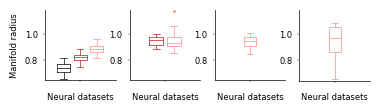

In [139]:
GAP = 0.2
MARKERSIZE = 2
YLIM = [0.65, 1.18]
fig, axes = plt.subplots(1, 4, figsize=(4.2, 1))

# KS 3.0 --------------------

plot_data = pd.DataFrame()
plot_data["Truth"] = out_true["true_units"][0]["metrics_per_class"]["radius"]
plot_data["Sorted single units"] = out_ks3["sorted_single_unit"][0][
    "metrics_per_class"
]["radius"]
plot_data["All sorted units"] = out_ks3["all_sorted_units"][0]["metrics_per_class"][
    "radius"
]
plot_data = plot_data.melt()

ax = sns.boxplot(
    ax=axes[0],
    data=plot_data,
    hue="variable",
    y="value",
    fill=False,
    palette=colors,
    gap=GAP,
    linewidth=plt.rcParams["lines.linewidth"],
    flierprops={"marker": ".", "markersize": MARKERSIZE},
    width=0.7,
)
axes[0].set_box_aspect(1)
axes[0].spines[["top", "right"]].set_visible(False)
axes[0].get_legend().remove()
# axes[0].legend(frameon=False, loc="upper left", bbox_to_anchor=(0.8, 1))
axes[0].set_ylabel("Manifold radius")
axes[0].set_xlabel("Neural datasets")
axes[0].set_ylim(YLIM)

# KS 2.5 --------------------

plot_data = pd.DataFrame()
plot_data["Sorted single units"] = (
    out_ks2_5["sorted_single_unit"][0]["metrics_per_class"]["radius"]
    / out_ks2_5["sorted_single_unit"][1]["metrics_per_class"]["radius"]
)
plot_data["All sorted units"] = (
    out_ks2_5["all_sorted_units"][0]["metrics_per_class"]["radius"]
    / out_ks2_5["all_sorted_units"][1]["metrics_per_class"]["radius"]
)
plot_data = plot_data.melt()

ax = sns.boxplot(
    ax=axes[1],
    data=plot_data,
    hue="variable",
    y="value",
    fill=False,
    palette=colors[1:],
    gap=GAP,
    linewidth=plt.rcParams["lines.linewidth"],
    flierprops={"marker": ".", "markersize": MARKERSIZE},
    width=0.5,
)
axes[1].set_box_aspect(1)
axes[1].get_legend().remove()
# axes[1].legend(frameon=False, loc="upper left", bbox_to_anchor=(0.8, 1))
axes[1].spines[["top", "right"]].set_visible(False)
axes[1].set_xlabel("Neural datasets")
axes[1].set_ylim(YLIM)
axes[1].set_ylabel("")

# HS --------------------

plot_data = pd.DataFrame()
plot_data["All sorted units"] = (
    out_hs["all_sorted_units"][0]["metrics_per_class"]["radius"]
    / out_hs["all_sorted_units"][1]["metrics_per_class"]["radius"]
)
plot_data = plot_data.melt()

ax = sns.boxplot(
    ax=axes[2],
    data=plot_data,
    hue="variable",
    y="value",
    fill=False,
    palette=colors[2:],
    gap=GAP,
    linewidth=plt.rcParams["lines.linewidth"],
    flierprops={"marker": ".", "markersize": MARKERSIZE},
    width=0.2,
)
axes[2].set_box_aspect(1)
# axes[2].legend(frameon=False, loc="upper left", bbox_to_anchor=(0.8, 1))
axes[2].get_legend().remove()
axes[2].spines[["top", "right"]].set_visible(False)
axes[2].set_xlabel("Neural datasets")
axes[2].set_ylim(YLIM)
axes[2].set_ylabel("")
# KS --------------------

plot_data = pd.DataFrame()
plot_data["All sorted units"] = (
    out_ks["all_sorted_units"][0]["metrics_per_class"]["radius"]
    / out_ks["all_sorted_units"][1]["metrics_per_class"]["radius"]
)
plot_data = plot_data.melt()

ax = sns.boxplot(
    ax=axes[3],
    data=plot_data,
    hue="variable",
    y="value",
    fill=False,
    palette=colors[2:],
    gap=GAP,
    linewidth=plt.rcParams["lines.linewidth"],
    flierprops={"marker": ".", "markersize": MARKERSIZE},
    width=0.2,
)
axes[3].set_box_aspect(1)
# axes[3].legend(frameon=False, loc="upper left", bbox_to_anchor=(0.8, 1))
axes[3].get_legend().remove()
axes[3].spines[["top", "right"]].set_visible(False)
axes[3].set_xlabel("Neural datasets")
axes[3].set_ylabel("")
axes[3].set_ylim(YLIM)

# fig.subplots_adjust(wspace=0.5, hspace=0.1)

plt.savefig(
    "/gpfs/bbp.cscs.ch/project/proj85/home/laquitai/spikebias/figures/4_neural_code/svg/manifold_radii.svg",
    **savefig_cfg,
)

#### Dimension

We could normalize by min(M,N) the upper bound dimensionality but we already use Gaussian random projection to reduce and standardize 
the unit feature dimensionality of all response matrices to `N_new`.

In that case the upper bound dimensionality for all neural datasets is min(M=50, N=200) = 50, the number of sample per class.

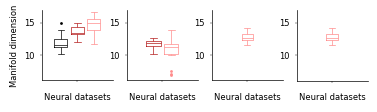

In [138]:
GAP = 0.2
MARKERSIZE = 2
METRICS = "dimension"
YLIM = [6, 17]
fig, axes = plt.subplots(1, 4, figsize=(4.2, 1))

# KS 3.0 --------------------

plot_data = pd.DataFrame()
plot_data["Truth"] = out_true["true_units"][0]["metrics_per_class"][METRICS]
plot_data["Sorted single units"] = out_ks3["sorted_single_unit"][0][
    "metrics_per_class"
][METRICS]
plot_data["All sorted units"] = out_ks3["all_sorted_units"][0]["metrics_per_class"][
    METRICS
]
plot_data = plot_data.melt()

# plot
ax = sns.boxplot(
    ax=axes[0],
    data=plot_data,
    hue="variable",
    y="value",
    fill=False,
    palette=colors,
    gap=GAP,
    linewidth=plt.rcParams["lines.linewidth"],
    flierprops={"marker": ".", "markersize": MARKERSIZE},
    width=0.7,
)
axes[0].set_box_aspect(1)
axes[0].spines[["top", "right"]].set_visible(False)
axes[0].legend(frameon=False, loc="upper left", bbox_to_anchor=(0.8, 1))
axes[0].get_legend().remove()
axes[0].set_ylabel("Manifold dimension")
axes[0].set_xlabel("Neural datasets")
axes[0].set_ylim(YLIM)

# KS 2.5 --------------------

plot_data = pd.DataFrame()
plot_data["Sorted single units"] = out_ks2_5["sorted_single_unit"][0][
    "metrics_per_class"
][METRICS]
plot_data["All sorted units"] = out_ks2_5["all_sorted_units"][0]["metrics_per_class"][
    METRICS
]
plot_data = plot_data.melt()

# plot
ax = sns.boxplot(
    ax=axes[1],
    data=plot_data,
    hue="variable",
    y="value",
    fill=False,
    palette=colors[1:],
    gap=GAP,
    linewidth=plt.rcParams["lines.linewidth"],
    flierprops={"marker": ".", "markersize": MARKERSIZE},
    width=0.5,
)
axes[1].set_box_aspect(1)
# axes[1].legend(frameon=False, loc="upper left", bbox_to_anchor=(0.8, 1))
axes[1].get_legend().remove()
axes[1].spines[["top", "right"]].set_visible(False)
axes[1].set_ylabel("")
axes[1].set_xlabel("Neural datasets")
axes[1].set_ylim(YLIM)


# HS --------------------

plot_data = pd.DataFrame()
plot_data["All sorted units"] = out_hs["all_sorted_units"][0]["metrics_per_class"][
    METRICS
]
plot_data = plot_data.melt()

# plot
ax = sns.boxplot(
    ax=axes[2],
    data=plot_data,
    hue="variable",
    y="value",
    fill=False,
    palette=colors[2:],
    gap=GAP,
    linewidth=plt.rcParams["lines.linewidth"],
    flierprops={"marker": ".", "markersize": MARKERSIZE},
    width=0.2,
)
axes[2].set_box_aspect(1)
# axes[2].legend(frameon=False, loc="upper left", bbox_to_anchor=(0.8, 1))
axes[2].get_legend().remove()
axes[2].spines[["top", "right"]].set_visible(False)
axes[2].set_ylabel("")
axes[2].set_xlabel("Neural datasets")
axes[2].set_ylim(YLIM)

# KS --------------------

plot_data = pd.DataFrame()
plot_data["All sorted units"] = out_hs["all_sorted_units"][0]["metrics_per_class"][
    METRICS
]
plot_data = plot_data.melt()

# plot
ax = sns.boxplot(
    ax=axes[3],
    data=plot_data,
    hue="variable",
    y="value",
    fill=False,
    palette=colors[2:],
    gap=GAP,
    linewidth=plt.rcParams["lines.linewidth"],
    flierprops={"marker": ".", "markersize": MARKERSIZE},
    width=0.2,
)
axes[3].set_box_aspect(1)
# axes[3].legend(frameon=False, loc="upper left", bbox_to_anchor=(0.8, 1))
axes[3].get_legend().remove()
axes[3].spines[["top", "right"]].set_visible(False)
axes[3].set_ylabel("")
axes[3].set_xlabel("Neural datasets")
axes[3].set_ylim(YLIM)

# save fig
plt.savefig(
    PROJ_PATH + "/figures/4_neural_code/svg/manifold_dimension.svg",
    **savefig_cfg,
)

In [90]:
out_hs["all_sorted_units"][0]["metrics_per_class"][METRICS]

array([12.56739201, 13.23787268, 11.51501378, 13.93006519, 12.19485234,
       12.28160017, 12.46921641, 12.06494291, 11.77873262, 12.2317266 ,
       12.7777047 , 12.51607997, 12.96891564, 13.171467  , 13.15396575,
       13.31720464, 14.1200178 , 12.58799516, 12.30451754, 12.36281603])

#### Centroid correlation

2024-02-24 14:18:20,000 - matplotlib.legend - legend.py - _parse_legend_args - WARNING - No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
[0.07061305111261482, 0.06949389406294815, 0.07005654961150318]
[0.07061305111261482, 0.07060403837503196, 0.07043657025634727]


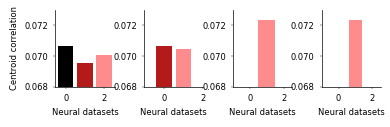

In [137]:
GAP = 0.2
MARKERSIZE = 2
METRICS = "correlation"
YLIM = [0.068, 0.073]
fig, axes = plt.subplots(1, 4, figsize=(4.2, 1))

# KS 3.0 --------------------

true_corr = out_true["true_units"][0]["metrics_per_class"][METRICS]
sorted_single_unit_corr_ks3 = out_ks3["sorted_single_unit"][0]["metrics_per_class"][
    METRICS
]
all_sorted_unit_corr_ks3 = out_ks3["all_sorted_units"][0]["metrics_per_class"][METRICS]

# plot
axes[0].bar(
    [0, 1, 2],
    [true_corr, sorted_single_unit_corr_ks3, all_sorted_unit_corr_ks3],
    color=colors,
)

# add legend
axes[0].spines[["top", "right"]].set_visible(False)
axes[0].legend(frameon=False, loc="upper left", bbox_to_anchor=(0.8, 1))
axes[0].set_ylabel("Centroid correlation")
axes[0].set_xlabel("Neural datasets")
axes[0].set_ylim(YLIM)

# KS 2.5 --------------------

sorted_single_unit_corr_ks2_5 = out_ks2_5["sorted_single_unit"][0]["metrics_per_class"][
    METRICS
]
all_sorted_unit_corr_ks2_5 = out_ks2_5["all_sorted_units"][0]["metrics_per_class"][
    METRICS
]

# plot
axes[1].bar(
    [0, 1],
    [sorted_single_unit_corr_ks2_5, all_sorted_unit_corr_ks2_5],
    color=colors[1:],
    width=0.8,
)

# add legend
axes[1].spines[["top", "right"]].set_visible(False)
axes[1].set_ylabel("")
axes[1].set_xlabel("Neural datasets")
axes[1].set_ylim(YLIM)
axes[1].set_xlim([-1, 2])

# HS --------------------

all_sorted_unit_corr_hs = out_hs["all_sorted_units"][0]["metrics_per_class"][METRICS]

# plot
axes[2].bar([1], [all_sorted_unit_corr_hs], color=colors[2:], width=1)

# add legend
axes[2].spines[["top", "right"]].set_visible(False)
axes[2].set_ylabel("")
axes[2].set_xlabel("Neural datasets")
axes[2].set_ylim(YLIM)
axes[2].set_xlim([-1, 2.5])

# KS --------------------

all_sorted_unit_corr_ks = out_hs["all_sorted_units"][0]["metrics_per_class"][METRICS]

# plot
axes[3].bar([1], [all_sorted_unit_corr_ks], color=colors[2:])

# add legend
axes[3].spines[["top", "right"]].set_visible(False)
axes[3].set_ylabel("")
axes[3].set_xlabel("Neural datasets")
axes[3].set_ylim(YLIM)
axes[3].set_xlim([-1, 2.5])

fig.subplots_adjust(wspace=0.5, hspace=0.1)

plt.savefig(
    "/gpfs/bbp.cscs.ch/project/proj85/home/laquitai/spikebias/figures/4_neural_code/svg/manifold_correlation.svg",
    **savefig_cfg,
)

print([true_corr, sorted_single_unit_corr_ks3, all_sorted_unit_corr_ks3])
print([true_corr, sorted_single_unit_corr_ks2_5, all_sorted_unit_corr_ks2_5])